# CS405_Lab5_CNN Architectures_and_Transfer_Learning


# TASKS FOR THE LAB:

There are two parts for this elaborative lab that you will have to carry out, but first and foremost, **listen to your instructor and read the instructions carefully. It will help you understand and perform the lab easily.**

1. You will be preparing a report for answering the specific questions asked throughout this notebook. Please be attentive to avoid missing any such questions.
2. As the title suggests this lab is designed for you to learn to implement CNN architectures by yourselves and also use the pretrained architectures available to you thanks to the scientific community. The tasks for this part will appear to you as you scroll down the notebook.

Other than that, we are also going to learn the following very useful aspects of a deep learning project that are used very frequently:

* Tensorboard
  * Log data
  * Visualize the model
*   Checkpointing: Saving the optimizer, scheduler and other metrics along with the model for resuming training in the future

Note: Once you have completed the lab, consider retaining this notebook as your primary resource for any potential future utilization of the provided code, like for checkpointing or integrating with TensorBoard for various purposes

# Package installations and imports  

In [4]:
import torch
import torchvision
import os
from PIL import Image
import matplotlib.pyplot as plt
%matplotlib inline
import torch.nn as nn
import numpy as np
from tqdm import tqdm
from torchsummary import summary

In [5]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [6]:
device = "cuda" if torch.cuda.is_available() else "cpu"

In [7]:
!pip install --upgrade --no-cache-dir gdown

# Data Preparation

## Vegetable Dataset

For this lab, we will be using only the test set of the Vegetable Dataset as our working dataset consisting of only 3000 Images because today's lab is about using pretrained networks and how can we achieve good performance with them when we have less amounts of data. We will divide this data into train, validation and test sets (with a split of 70%, 15% and 15%, respectively. Another purpose of doing this is to perform quick train, validation and testing experiments with a small dataset.

Train: 2100

Val: 450

Test: 450

https://www.kaggle.com/datasets/misrakahmed/vegetable-image-dataset

## Download and unzip the dataset

In [8]:
# download test_set
!gdown https://drive.google.com/file/d/1aXaH7F6iNlK2mqzZBY_mMF5uazwQHM7W/view?usp=sharing --fuzzy

Downloading...
From (original): https://drive.google.com/uc?id=1aXaH7F6iNlK2mqzZBY_mMF5uazwQHM7W
From (redirected): https://drive.google.com/uc?id=1aXaH7F6iNlK2mqzZBY_mMF5uazwQHM7W&confirm=t&uuid=42c842d0-8e17-4c95-8259-cb628ad3da34
To: /content/vegetable_test.zip
100% 80.3M/80.3M [00:00<00:00, 135MB/s]


In [9]:
%%capture
!unzip /content/vegetable_test.zip;

## Loading the train, val and test sets from their respective folders

### Initializing ImageFolder (dataset) Instances

In [10]:
image_size = 224
batch_size = 64

In this lab, we will learn about using pre-trained models.

In order to quickly execute training loops and prove that using pretrained models help us achieve good results with less amounts of data we will use split the test set of the vegetable dataset as the train_set, val_set and test_set.

## Question 1: What does the torchvision.transforms.Compose() function do in the cell below?

In [11]:
transform = torchvision.transforms.Compose([torchvision.transforms.ToTensor(), torchvision.transforms.Resize((image_size,image_size))])

# Answer:

The above function allows the torchvision data to be converted into a tensor and then resized into size of the image_size set. These functionality is then stored into variable transform for future use.

The compose transforms function is used to apply transformations and the compose function keeps in check the sequence of the transformations.

## Question 2: What is the torchvision.datasets.ImageFolder() method used for in the cell below? What are its arguments?

In [12]:
# path to our datset
data_path = '/content/vegetable_test'

#Initialize the dataset instance from the given datapath
data_set = torchvision.datasets.ImageFolder(root=data_path, transform=transform)

# Answer

ImageFolder is a special function which takes a folder and converts it into a dataset, the images in a particular subfolder and labelled as the the subfolder "name".

The transform variable transforms the images before loading them into the dataset.

In [13]:
#Side note: you can access transform of a dataset object like this:
data_set.transform

Compose(
    ToTensor()
    Resize(size=(224, 224), interpolation=bilinear, max_size=None, antialias=True)
)

In [14]:
# Split the dataset into train, validation and test splits
train_set, val_set, test_set = torch.utils.data.random_split(data_set, [2100, 450, 450], generator=torch.Generator().manual_seed(42))

In [15]:
#Side note: For subset of the data_set like train_set, you can access its transform like this:
train_set.dataset.transform

Compose(
    ToTensor()
    Resize(size=(224, 224), interpolation=bilinear, max_size=None, antialias=True)
)

In [16]:
# Class to number of instances
# caution: takes some time to complete for large datasets
total = 0
class_counts = np.zeros(len(train_set.dataset.classes))
for image, label in train_set:
    class_counts[label] += 1
    total +=1
for i in range(len(class_counts)):
  print("class:%s, instances: %d"%([k for k,v in train_set.dataset.class_to_idx.items() if v == i], class_counts[i]))

class:['Bean'], instances: 145
class:['Bitter_Gourd'], instances: 141
class:['Bottle_Gourd'], instances: 138
class:['Brinjal'], instances: 144
class:['Broccoli'], instances: 126
class:['Cabbage'], instances: 134
class:['Capsicum'], instances: 141
class:['Carrot'], instances: 155
class:['Cauliflower'], instances: 133
class:['Cucumber'], instances: 144
class:['Papaya'], instances: 142
class:['Potato'], instances: 143
class:['Pumpkin'], instances: 128
class:['Radish'], instances: 144
class:['Tomato'], instances: 142


## Question 3: What is the if-elif condition used for in the cell below?

In [17]:
# Print the classes in the dataset
classes = None
if hasattr(train_set, 'classes'):
      classes = train_set.classes
elif hasattr(train_set, 'dataset') and hasattr(train_set.dataset, 'classes'):
      classes = train_set.dataset.classes

classes

['Bean',
 'Bitter_Gourd',
 'Bottle_Gourd',
 'Brinjal',
 'Broccoli',
 'Cabbage',
 'Capsicum',
 'Carrot',
 'Cauliflower',
 'Cucumber',
 'Papaya',
 'Potato',
 'Pumpkin',
 'Radish',
 'Tomato']

# Answer

The above if-elif statement checks for the class labels, if the classes are a direct object of trainset they are returned in the above case they are not!

The classes are linked to the dataset wrapper that wraps the trainset because of our applied transformation and hence elif statement executes in the above.

## Function for visualizing images of dataset object

In [18]:
def show_dataset_samples(data_set):
    loader = torch.utils.data.DataLoader(
    data_set,
    batch_size=32,
    shuffle=True)

  # Get a batch of images from the train_loader
    images, labels = next(iter(loader))

    rows = col = 3
    #fig, axes = plt.subplots(nrows=5, ncols=5)                          )
    plt.figure(figsize = (10,10))

    for i in range(rows*col):
      # Plot a random image from the batch
      random_index = np.random.randint(0, images.shape[0])
      image = images[random_index]
      label = labels[random_index]
      plt.subplot(rows, col, i+1)
      plt.axis('off')
      plt.imshow(image.permute(1,2,0))

      if hasattr(train_set, 'classes'):
        classes = train_set.classes
      elif hasattr(train_set, 'dataset') and hasattr(train_set.dataset, 'classes'):
        classes = train_set.dataset.classes

      plt.title(f'Label: {classes[label]}')

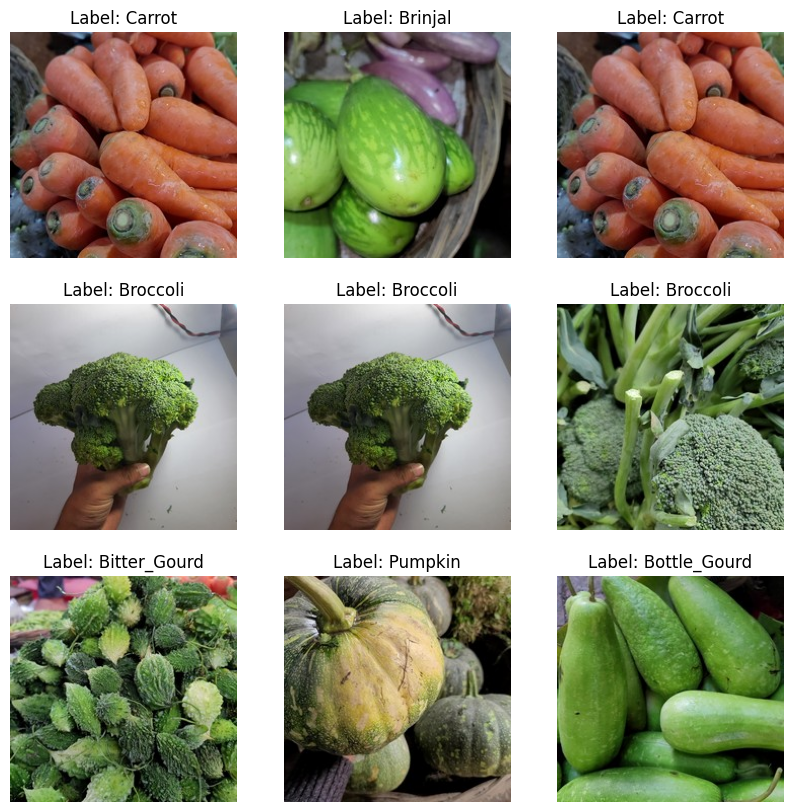

In [19]:
show_dataset_samples(train_set)

## Compute standardization parameters and apply

In [20]:
def get_mean_and_std(dataloader):
    channels_sum, channels_squared_sum, num_batches = 0, 0, 0
    for data, _ in dataloader:
        # Mean over batch, height and width, but not over the channels
        channels_sum += torch.mean(data, dim=[0,2,3])
        channels_squared_sum += torch.mean(data**2, dim=[0,2,3])
        num_batches += 1

    mean = channels_sum / num_batches

    # std = sqrt(E[X^2] - (E[X])^2)
    std = (channels_squared_sum / num_batches - mean ** 2) ** 0.5

    return mean, std

# https://towardsdatascience.com/how-to-calculate-the-mean-and-standard-deviation-normalizing-datasets-in-pytorch-704bd7d05f4c

## Question 4: Why are we calculating the mean and std of only the trian_set in the cell below? Why not calculate for the whole dataset?

# Answer

We cannot use the metrics from the whole dataset as it includes the validation and test set, if we were to use it the model will perform better on the training data but will not generalize well.

Therefore, we only use training data and its metrics in the training process to avoid peeking into the rest of the dataset.

In [21]:
# Create a dummy dataloader for our train_set
dataloader = torch.utils.data.DataLoader(dataset=train_set, batch_size=32)
# Call the function and compute mean and std
mean, std = get_mean_and_std(dataloader)
print(mean, std)

tensor([0.4681, 0.4648, 0.3449]) tensor([0.2338, 0.2292, 0.2433])


In [22]:
# Add the new normalization to the existing transforms
normalize = torchvision.transforms.Normalize(mean=mean, std=std)
transform = torchvision.transforms.Compose([transform, normalize])

## Question 5: How are we updating the transforms of our subsets in the cell below?

# Answer

The below provided code first checks for the transform attribite directly linked dataset.

In above case due to previous conversion into tensor and resize transformations are available the transform attribute is linked to the wrapper dataset and not directly and hense elif statement in executed.

In [23]:
# A function for updating the transforms of our dataset objects
def update_transform(dataset, transform):
    if hasattr(dataset, 'transform'):
      dataset.transform = transform
      dataset.transform
    elif hasattr(dataset, 'dataset') and hasattr(dataset.dataset, 'transform'):
      dataset.dataset.transform = transform
      dataset.dataset.transform
    else:
      print("No transform attribute found.")

In [24]:
# Add the normalization transform to the datasets
# using the "update_transform" function
update_transform(train_set, transform)
update_transform(val_set, transform)
update_transform(test_set, transform)

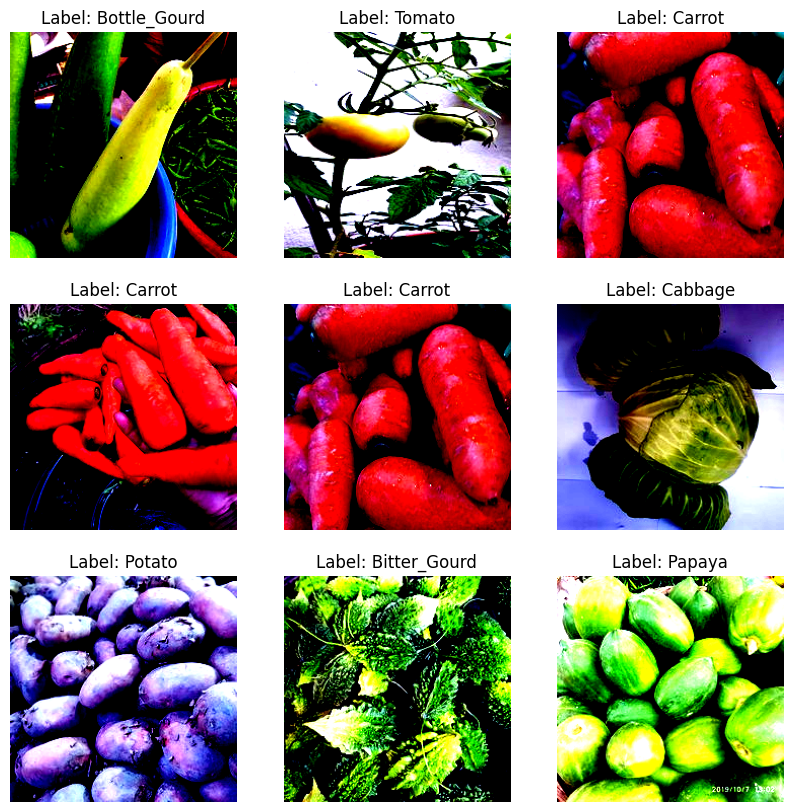

In [25]:
### Visualize the images with the new normalization transform
show_dataset_samples(train_set)

## Data Augmentation

## Question 6: What transforms are we using in the cell below?


# Answer

The cell below uses data augmentation transforms, specifically Horizontal, Vertical Flips followed by a 45 degrees rotation and then blur added to it.

## Question 7: Why are we only applying them to the train_set?

# Answer

Data augmentation helps generalize and provide more variable datasets from the same dataset. This not only increases the dataset but also imporoves the model performance.

Applying the augmentation to the test or validation set will impact the results. Applying augmentations to these sets would make them inconsistent, as augmentation changes the image data on each pass. By keeping validation and test images static, we can accurately assess the model's ability to generalize without interference from random transformations.

In [26]:
# composing transforms instance for data augmentation
augmentation_transforms = torchvision.transforms.Compose([transform,
    torchvision.transforms.RandomHorizontalFlip(),
    torchvision.transforms.RandomVerticalFlip(),
    torchvision.transforms.RandomRotation(degrees=45),
    torchvision.transforms.GaussianBlur(5)
    ])

# Add the augmentation_transfomers to the train_set
update_transform(train_set, transform)

## Initializing the pytorch dataloaders and visualize train examples

In [27]:
train_loader = torch.utils.data.DataLoader(
    train_set,
    batch_size=batch_size,
    shuffle=True
)

val_loader = torch.utils.data.DataLoader(
    val_set,
    batch_size=batch_size,
    shuffle=False
)

test_loader = torch.utils.data.DataLoader(
    test_set,
    batch_size=batch_size,
    shuffle=False
)


# Convolutional Neural Networks Architectures

# TASKS
# You have two tasks to perform in this lab:

## Task 1:
In the cells below the VGG16 model has been manually implemented for you to initialize a VGG16 model with random variables. You have also been provided code for using a pretrained VGG16 model.

1. You are to first train the manually implemented model from scratch for 15 epochs, save its training and validation plots and evaluate it on the test set.

2. Then, using the provided code, fine-tune the pre-trained model for a 3 epochs, save its training and validation plots and evaluate it on the test set.  

Compare the performance and traning plots of the pre-trained model with those of the model trained from scratch. Report and discuss your observations in the Lab Report for both models.

## Task 2:
Train a pretrained ResNet-50 model on the same dataset for a few epochs 2-3 epochs, save its plots, evaluate it on the test set and compare its performance with that of the pre-trained VGG-16 model. Report and discuss your observations.



## VGG-16 Manual Implementation and Random Initialization
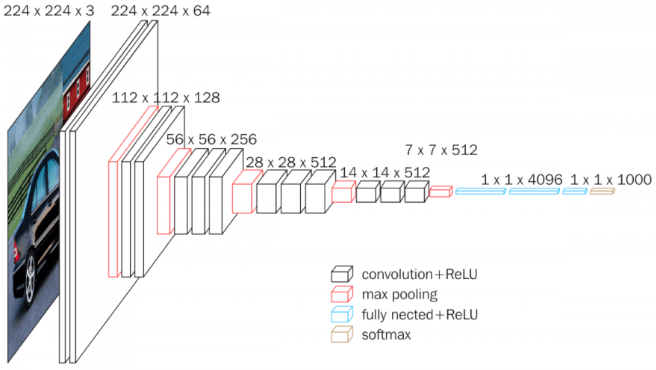

In [28]:
class VGG16(nn.Module):
    def __init__(self, num_classes=15, im_height=224, im_width=224):

        super(VGG16, self).__init__()

        max_pool_count = 5
        size_reduction_factor = 2**max_pool_count
        out_height = im_height // size_reduction_factor
        out_width = im_width // size_reduction_factor

        self.layer1 = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU())

        self.layer2 = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size = 2, stride = 2))

        self.layer3 = nn.Sequential(
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU())

        self.layer4 = nn.Sequential(
            nn.Conv2d(128, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size = 2, stride = 2))

        self.layer5 = nn.Sequential(
            nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU())

        self.layer6 = nn.Sequential(
            nn.Conv2d(256, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU())

        self.layer7 = nn.Sequential(
            nn.Conv2d(256, 256, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size = 2, stride = 2))

        self.layer8 = nn.Sequential(
            nn.Conv2d(256, 512, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU())

        self.layer9 = nn.Sequential(
            nn.Conv2d(512, 512, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU())

        self.layer10 = nn.Sequential(
            nn.Conv2d(512, 512, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size = 2, stride = 2))

        self.layer11 = nn.Sequential(
            nn.Conv2d(512, 512, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU())

        self.layer12 = nn.Sequential(
            nn.Conv2d(512, 512, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU())

        self.layer13 = nn.Sequential(
            nn.Conv2d(512, 512, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size = 2, stride = 2))

        self.fc = nn.Sequential(
            nn.Dropout(0.5),
            nn.Linear(out_height*out_width*512, 4096),
            nn.ReLU())

        self.fc1 = nn.Sequential(
            nn.Dropout(0.5),
            nn.Linear(4096, 4096),
            nn.ReLU())

        self.fc2= nn.Sequential(
            nn.Linear(4096, num_classes))

    def forward(self, x):
        out = self.layer1(x)
        out = self.layer2(out)
        out = self.layer3(out)
        out = self.layer4(out)
        out = self.layer5(out)
        out = self.layer6(out)
        out = self.layer7(out)
        out = self.layer8(out)
        out = self.layer9(out)
        out = self.layer10(out)
        out = self.layer11(out)
        out = self.layer12(out)
        out = self.layer13(out)
        out = out.reshape(out.size(0), -1)
        out = self.fc(out)
        out = self.fc1(out)
        out = self.fc2(out)
        return out

# Source: https://blog.paperspace.com/vgg-from-scratch-pytorch/

## Question 8: Instead of fine-tuning the pre-trained model for a few epochs what would happen if we train the pre-trained model for a large number of epochs on the train_set?

# Answer

If a pre-trained model is trained for too many epochs, it could lead to:

Overfitting: The model may overfit the training data, learning dataset-specific noise rather than general features.

Decreased Generalization: Excessive fine-tuning can deteriorate the model’s ability to generalize to unseen data, especially if the model deviates too far from the learned weights of the original pre-training on large datasets like ImageNet.

In [29]:
model = VGG16()

## Loss Function and Optimizer Selection

In [30]:
# Select a loss function
loss_function = torch.nn.CrossEntropyLoss()

# Select an optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

# Define the learning rate scheduler
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=40, gamma=0.1)
# For more on schedulers please visit:
# https://towardsdatascience.com/a-visual-guide-to-learning-rate-schedulers-in-pytorch-24bbb262c863

# Set the number of epochs
# This variable is used in the main training loop
epochs = 15 # Define the Epochs

model.to(device);


# Training

## Function for running the model over all the samples of a given dataloader object

In [31]:
def run_1_epoch(model, loss_fn, loader, optimizer = None, train = False):

  if train:
    model.train()
  else:
    model.eval()


  total_correct_preds = 0

  total_loss = 0

  # Number of images we can get by the loader
  total_samples_in_loader = len(loader.dataset)

  # number of batches we can get by the loader
  total_batches_in_loader = len(loader)

  for image_batch, labels in tqdm(loader):

    # Transfer image_batch to GPU if available
    image_batch = image_batch.to(device)
    labels = labels.to(device)

    # Zeroing out the gradients for parameters
    if train:
      assert optimizer is not None, "Optimizer must be provided if train=True"
      optimizer.zero_grad()

    # Forward pass on the input batch
    output = model(image_batch)

    # Acquire predicted class indices
    _, predicted = torch.max(output.data, 1) # the dimension 1 corresponds to max along the rows

    # Removing extra last dimension from output tensor
    output.squeeze_(-1)

    # Compute the loss for the minibatch
    loss = loss_function(output, labels)

    # Backpropagation
    if train:
      loss.backward()

    # Update the parameters using the gradients
    if train:
      optimizer.step()

    # Extra variables for calculating loss and accuracy
    # count total predictions for accuracy calcutuon for this epoch
    total_correct_preds += (predicted == labels).sum().item()

    total_loss += loss.item()

  loss = total_loss / total_batches_in_loader
  accuracy = 100 * total_correct_preds / total_samples_in_loader

  return loss, accuracy

In [32]:
# Initializing variables for starting a new training
# Some helper variables

train_accuracy_list = []
val_accuracy_list = []

train_loss_list = []
val_loss_list = []


val_accuracy_max = -1

checkpoint_path = '/content/VGG16_checkpoint.pth' # Define the path
best_val_checkpoint_path = '/content/VGG16_best_val_checkpoint.pth' # Define the path

# Start epoch is zero for new training
start_epoch = 0

## Setting up Tensorboard

## Question 9: What do you observe in the cells given below related to Tensorboard? Please discuss in the report. How do you enable the tensorboard in the colab environment like this one?

# Answer

Tensorboard extension is enabled in collab, a summary writer is added to it and then the training graphs are printed.

The link to the tensorboard is provided and can also be viewed in the cell outputs directly.

In [33]:
import tensorboard
from torch.utils.tensorboard import SummaryWriter

In [34]:
# A command starting with % is called a magic command
# This command is used for loading the tensorboard extension for
# enabling it to be able to run in this colab notebook
%load_ext tensorboard

# Otherwise when it is installed in your PC the tensorboard is run through the
# browser. Once it is run, you use the provided address to access it through
# a browser on your PC.

In [35]:
# Initialize the SummaryWriter instance. The default log_dir is set to runs/
# Here we have speified our own log directory
writer = SummaryWriter(log_dir="/content/VGG16_runs/")

In [36]:
sample_images, labels = next(iter(train_loader))

# The add_graph method is used to visualize the model
# We provide the model and sample image
writer.add_graph(model, sample_images.to(device))

### Note: Once the tensorboard interface is showing and the training has been started, you may click on the referesh button to start visualizing the training curves.

In [37]:
# The % sign is the magic command for the tensorboard to run in colab
#
%tensorboard --logdir /content/VGG16_runs/

# For more details:
# https://pytorch.org/tutorials/intermediate/tensorboard_tutorial.html

<IPython.core.display.Javascript object>

# Run Graph Output

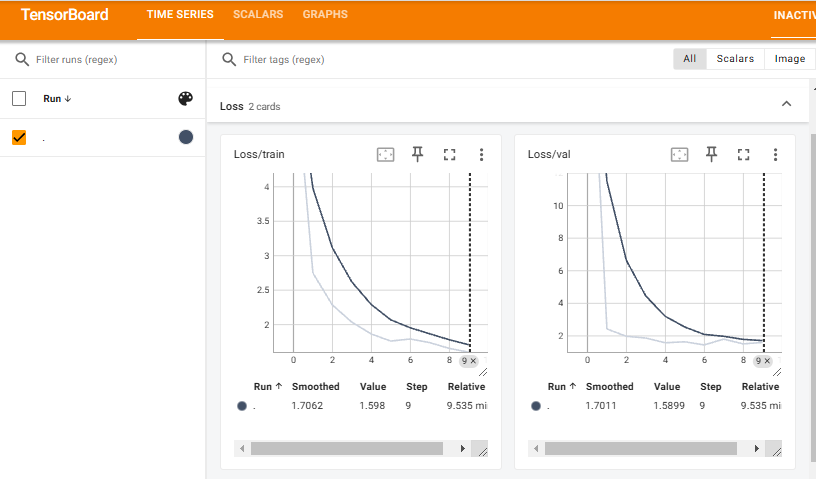

## Main training loop

## Question 10: How is modularity introduced in the over training of our model in this notebook? What does run_1_epoch() actually do in this case?   

# Answer

The function run_1_epoch() is designed to handle both training and validation based on the train flag (True for training, False for validation). This helps keep the code modular and avoids redundancy, as the same function is used for both phases by simply switching its mode.

The function run_1_epoch processes the data in batches for a single epoch. During training (train=True), it will compute the gradients and update the model parameters. For validation (train=False), it just calculates the loss and accuracy without updating parameters.

## Question 11: How are we logging Tensorboard values in the cell below? Are you observing the training plots during the training of your the implemented VGG16 model?

# Answer

Logging Process: TensorBoard logs are generated using the writer.add_scalar method. This function logs the training and validation loss, along with accuracy for each epoch. Each metric has a unique tag and logs are recorded at the global_step, which here is the epoch number.

Observing Training Plots: If TensorBoard is running, these logs will appear as dynamic plots during training, providing a real-time view of the model's performance, such as loss reduction and accuracy improvements.

## Question 12: Please discuss about the checkpointing in the cell below. How is it implemented?

# Answer

Checkpointing Logic: The code saves checkpoints in two cases:
Best Model Checkpoint: If the current epoch's validation accuracy (val_accuracy) is higher than all previous epochs, the model's state (along with optimizer, scheduler, and other training details) is saved to best_val_checkpoint_path.

Epoch-End Checkpoint: At the end of every epoch, the current state of the model is saved to checkpoint_path, regardless of performance. This ensures that training progress is always stored, even if the best accuracy is not reached.

Implementation: The checkpoint stores components that we would need in future.

In [38]:
# Main training and validation loop for n number of epochs
for epoch in range(start_epoch, epochs):

  # Train model for one epoch

  # Get the current learning rate from the optimizer
  current_lr = optimizer.param_groups[0]['lr']

  print("Epoch %d: Train \nLearning Rate: %.6f"%(epoch, current_lr))
  train_loss, train_accuracy  = run_1_epoch(model, loss_function, train_loader, optimizer, train= True)

  # Update the learning rate scheduler
  scheduler.step()

  # Lists for train loss and accuracy for plotting
  train_loss_list.append(train_loss)
  train_accuracy_list.append(train_accuracy)

  # Validate the model on validation set
  print("Epoch %d: Validation"%(epoch))
  with torch.no_grad():
    val_loss, val_accuracy  = run_1_epoch(model, loss_function, val_loader, optimizer, train= False)

  # Lists for val loss and accuracy for plotting
  val_loss_list.append(val_loss)
  val_accuracy_list.append(val_accuracy)

  # The "add_scalar" function adds a new metric to the tensorboard log
  # It is gnerally given 3 arguments:
  # tag: Name of the metric
  # scalar_value = the value of the metric to record
  # global_step = on which milestone to record the scalar value which in our
  # case is the epoch
  writer.add_scalar(tag = "Loss/train", scalar_value = train_loss, global_step = epoch)
  writer.add_scalar(tag = "accuracy/train", scalar_value = train_accuracy, global_step = epoch)

  writer.add_scalar(tag = "Loss/val", scalar_value = val_loss, global_step = epoch)
  writer.add_scalar(tag = "accuracy/val", scalar_value = val_accuracy, global_step = epoch)

  print('train loss: %.4f'%(train_loss))
  print('val loss: %.4f'%(val_loss))
  print('train_accuracy %.2f' % (train_accuracy))
  print('val_accuracy %.2f' % (val_accuracy))

  # Save model if validation accuracy for current epoch is greater than
  # all the previous epochs
  if val_accuracy > val_accuracy_max:
    val_accuracy_max = val_accuracy
    print("New max val Accuracy Acheived %.2f. Saving model.\n\n"%(val_accuracy_max))

    checkpoint = {
    'model': model.state_dict(),
    'optimizer': optimizer.state_dict(),
    'scheduler': scheduler.state_dict(),
    'trianed_epochs': epoch,
    'train_losses': train_loss_list,
    'train_accuracies': train_accuracy_list,
    'val_losses': val_loss_list,
    'val_accuracies': val_accuracy_list,
    'val_accuracy_max': val_accuracy_max,
    'lr': optimizer.param_groups[0]['lr']
    }
    torch.save(checkpoint, best_val_checkpoint_path)

  else:
    print("val accuracy did not increase from %.2f\n\n"%(val_accuracy_max))

# Save checkpoint for the last epoch
  checkpoint = {
    'model': model.state_dict(),
    'optimizer': optimizer.state_dict(),
    'scheduler': scheduler.state_dict(),
    'trianed_epochs': epoch,
    'train_losses': train_loss_list,
    'train_accuracies': train_accuracy_list,
    'val_losses': val_loss_list,
    'val_accuracies': val_accuracy_list,
    'val_accuracy_max': val_accuracy_max,
    'lr': optimizer.param_groups[0]['lr']
    }

  torch.save(checkpoint, checkpoint_path)
  writer.flush()


Epoch 0: Train 
Learning Rate: 0.001000


100%|██████████| 33/33 [00:37<00:00,  1.15s/it]


Epoch 0: Validation


100%|██████████| 8/8 [00:03<00:00,  2.64it/s]


train loss: 6.2925
val loss: 2.8987
train_accuracy 10.81
val_accuracy 7.78
New max val Accuracy Acheived 7.78. Saving model.


Epoch 1: Train 
Learning Rate: 0.001000


100%|██████████| 33/33 [00:38<00:00,  1.16s/it]


Epoch 1: Validation


100%|██████████| 8/8 [00:03<00:00,  2.20it/s]


train loss: 2.5630
val loss: 2.4800
train_accuracy 13.24
val_accuracy 12.22
New max val Accuracy Acheived 12.22. Saving model.


Epoch 2: Train 
Learning Rate: 0.001000


100%|██████████| 33/33 [00:37<00:00,  1.14s/it]


Epoch 2: Validation


100%|██████████| 8/8 [00:03<00:00,  2.45it/s]


train loss: 2.4679
val loss: 2.4848
train_accuracy 15.43
val_accuracy 12.44
New max val Accuracy Acheived 12.44. Saving model.


Epoch 3: Train 
Learning Rate: 0.001000


100%|██████████| 33/33 [00:38<00:00,  1.15s/it]


Epoch 3: Validation


100%|██████████| 8/8 [00:03<00:00,  2.46it/s]


train loss: 2.4409
val loss: 2.4038
train_accuracy 15.71
val_accuracy 12.89
New max val Accuracy Acheived 12.89. Saving model.


Epoch 4: Train 
Learning Rate: 0.001000


100%|██████████| 33/33 [00:39<00:00,  1.20s/it]


Epoch 4: Validation


100%|██████████| 8/8 [00:03<00:00,  2.66it/s]


train loss: 2.3706
val loss: 2.4137
train_accuracy 16.95
val_accuracy 14.00
New max val Accuracy Acheived 14.00. Saving model.


Epoch 5: Train 
Learning Rate: 0.001000


100%|██████████| 33/33 [00:38<00:00,  1.18s/it]


Epoch 5: Validation


100%|██████████| 8/8 [00:03<00:00,  2.05it/s]


train loss: 2.3246
val loss: 2.3949
train_accuracy 18.00
val_accuracy 13.56
val accuracy did not increase from 14.00


Epoch 6: Train 
Learning Rate: 0.001000


100%|██████████| 33/33 [00:38<00:00,  1.16s/it]


Epoch 6: Validation


100%|██████████| 8/8 [00:03<00:00,  2.31it/s]


train loss: 2.3594
val loss: 2.3806
train_accuracy 17.33
val_accuracy 14.89
New max val Accuracy Acheived 14.89. Saving model.


Epoch 7: Train 
Learning Rate: 0.001000


100%|██████████| 33/33 [00:38<00:00,  1.15s/it]


Epoch 7: Validation


100%|██████████| 8/8 [00:03<00:00,  2.57it/s]


train loss: 2.3367
val loss: 2.2936
train_accuracy 18.05
val_accuracy 19.11
New max val Accuracy Acheived 19.11. Saving model.


Epoch 8: Train 
Learning Rate: 0.001000


100%|██████████| 33/33 [00:38<00:00,  1.16s/it]


Epoch 8: Validation


100%|██████████| 8/8 [00:03<00:00,  2.65it/s]


train loss: 2.2225
val loss: 2.1697
train_accuracy 19.71
val_accuracy 20.44
New max val Accuracy Acheived 20.44. Saving model.


Epoch 9: Train 
Learning Rate: 0.001000


100%|██████████| 33/33 [00:38<00:00,  1.17s/it]


Epoch 9: Validation


100%|██████████| 8/8 [00:03<00:00,  2.62it/s]


train loss: 2.1525
val loss: 1.9823
train_accuracy 22.19
val_accuracy 27.78
New max val Accuracy Acheived 27.78. Saving model.


Epoch 10: Train 
Learning Rate: 0.001000


100%|██████████| 33/33 [00:38<00:00,  1.16s/it]


Epoch 10: Validation


100%|██████████| 8/8 [00:03<00:00,  2.51it/s]


train loss: 2.1079
val loss: 2.0212
train_accuracy 22.90
val_accuracy 27.33
val accuracy did not increase from 27.78


Epoch 11: Train 
Learning Rate: 0.001000


100%|██████████| 33/33 [00:38<00:00,  1.17s/it]


Epoch 11: Validation


100%|██████████| 8/8 [00:03<00:00,  2.53it/s]


train loss: 2.0507
val loss: 2.0210
train_accuracy 25.67
val_accuracy 34.22
New max val Accuracy Acheived 34.22. Saving model.


Epoch 12: Train 
Learning Rate: 0.001000


100%|██████████| 33/33 [00:38<00:00,  1.17s/it]


Epoch 12: Validation


100%|██████████| 8/8 [00:03<00:00,  2.63it/s]


train loss: 1.9824
val loss: 1.9338
train_accuracy 27.24
val_accuracy 24.67
val accuracy did not increase from 34.22


Epoch 13: Train 
Learning Rate: 0.001000


100%|██████████| 33/33 [00:40<00:00,  1.22s/it]


Epoch 13: Validation


100%|██████████| 8/8 [00:03<00:00,  2.15it/s]


train loss: 2.0214
val loss: 1.9066
train_accuracy 26.33
val_accuracy 34.67
New max val Accuracy Acheived 34.67. Saving model.


Epoch 14: Train 
Learning Rate: 0.001000


100%|██████████| 33/33 [00:38<00:00,  1.17s/it]


Epoch 14: Validation


100%|██████████| 8/8 [00:03<00:00,  2.47it/s]


train loss: 1.9340
val loss: 1.8123
train_accuracy 29.43
val_accuracy 33.11
val accuracy did not increase from 34.67




In [39]:
# Copy best model to drive
# You may also directly save the best model to drive during training

!cp /content/VGG16_best_val_checkpoint.pth /content/drive

cp: cannot create regular file '/content/drive/VGG16_best_val_checkpoint.pth': Operation not supported


**Accuracy and Loss Result Graphs:**

Text(0.5, 1.0, 'Training and val Loss')

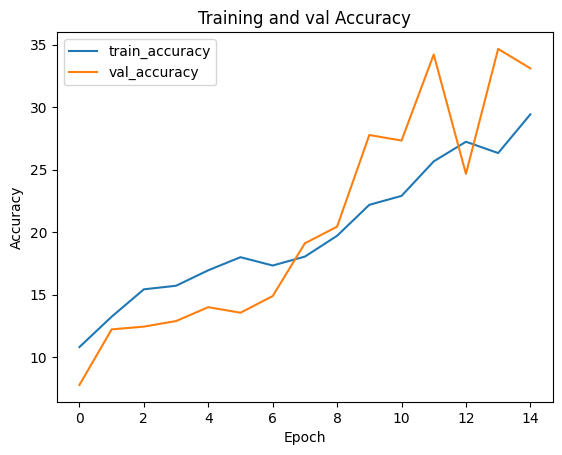

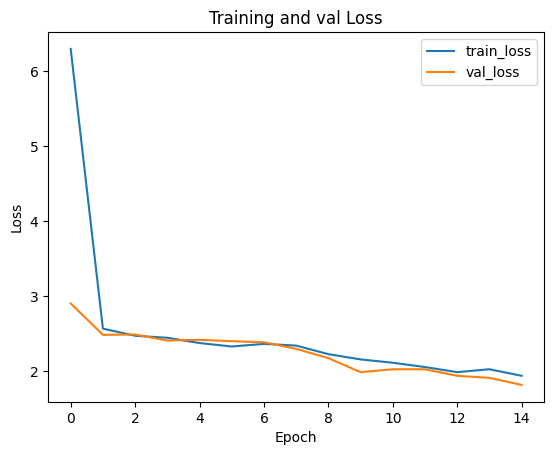

In [40]:
plt.figure()
plt.plot(train_accuracy_list, label="train_accuracy")
plt.plot(val_accuracy_list, label="val_accuracy")
plt.legend()

plt.xlabel('Epoch')
plt.ylabel('Accuracy')

plt.title('Training and val Accuracy')

plt.figure()
plt.plot(train_loss_list, label="train_loss")
plt.plot(val_loss_list, label="val_loss")

plt.legend()
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and val Loss')

# Evaluating the Model

**Loading the best saved model:**

In [41]:
best_val_model_path = '/content/VGG16_best_val_checkpoint.pth'
best_val_checkpoint = torch.load(best_val_model_path, map_location=torch.device(device))

<ipython-input-41-e5c6f6f7da65>:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_val_checkpoint = torch.load(best_val_model_path, map_location=torch.device(device))


In [42]:
# Before loading the state_dict of the model, make sure the "model" instance is
# initiated by its corresponding class e.g. VGG16
model.load_state_dict(best_val_checkpoint['model'])

<All keys matched successfully>

In [43]:
with torch.no_grad():
    test_loss, test_accuracy  = run_1_epoch(model, loss_function, test_loader, train= False)

print('test loss: %.4f'%(test_loss))
print('test_accuracy %.2f' % (test_accuracy))


100%|██████████| 8/8 [00:03<00:00,  2.16it/s]

test loss: 1.7664
test_accuracy 38.67


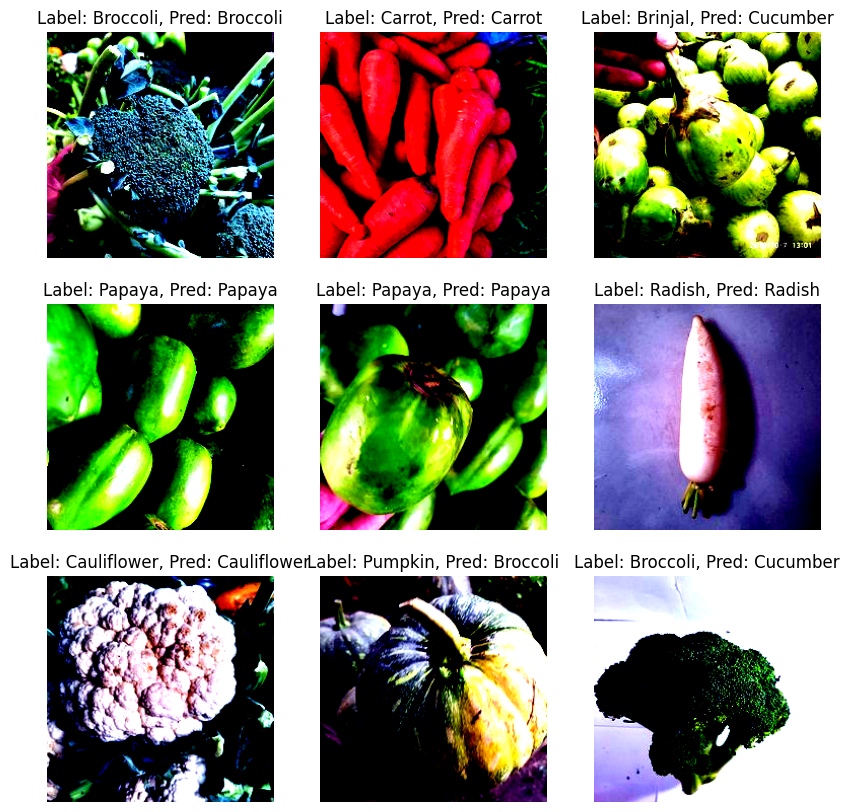

In [44]:
# Get a batch of images from the train_loader
images, labels = next(iter(test_loader))

with torch.no_grad():
  predicted_labels = model(images.to(device))
  predicted_labels = torch.argmax(predicted_labels, 1)
rows = col = 3
#fig, axes = plt.subplots(nrows=5, ncols=5))
plt.figure(figsize = (10,10))

for i in range(rows*col):
  # Plot a random image from the batch
  random_index = np.random.randint(0, images.shape[0])
  image = images[random_index]
  label = labels[random_index]
  pred_label = predicted_labels[random_index]
  plt.subplot(rows, col, i+1)
  plt.axis('off')
  plt.imshow(image.permute(1,2,0))
  plt.title(f'Label: {classes[label]}, Pred: {classes[pred_label]}')

# TorchVision Pretrained VGG16 Model

In [45]:
# https://pytorch.org/vision/stable/models.html
pretrained_VGG16_model = torchvision.models.vgg16(pretrained= True)

# Alternate method of initialization:
# modelVGG = torchvision.models.vgg19(weights=torchvision.models.VGG19_Weights)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:09<00:00, 55.5MB/s]


The "parameters()" attribute of a model returns us a generator that iteratively provides us the parameters of each layer of the model.

In the code below, we use a for loop to iterate over the parameters of each layer in the model.

The requires_grad flag for parameters of a layer signifies whether to calculate the gradients for those parameters when doing a backward pass. So initially we set requires_grad to false for parameters of all the layers

In [46]:
for param in pretrained_VGG16_model.parameters():
    param.requires_grad = False

In [47]:
pretrained_VGG16_model

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

### Replace an exisiting layer in model (VGG16)

The VGG16 model is divided into two sequential parts: First one is the "features" module and the second one is the classifer module. The "features" module consists of all the 2D opertation layers and the "classifier" module consists of all the fully connected layers.

In our case, the vegetable dataset has 15 classes, so we initialize a new layer and replace the last linear layer of the classifier that has 1000 outputs for 1000 classes of imagenet with the new layer with 15 outputs.


In [48]:
pretrained_VGG16_model.classifier[-1] = nn.Linear(in_features=4096, out_features= 15)
model = pretrained_VGG16_model

# Model Configuration

## Loss Function and Optimizer

In [49]:
# Select a loss function
loss_function = torch.nn.CrossEntropyLoss()

# Select an optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

# Define the learning rate scheduler
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=40, gamma=0.1)
# For more on schedulers please visit:
# https://towardsdatascience.com/a-visual-guide-to-learning-rate-schedulers-in-pytorch-24bbb262c863

# Set the number of epochs
# This variable is used in the main training loop
epochs = 3 # Define the Epochs

model.to(device);


# Training

In [50]:
def run_1_epoch(model, loss_fn, loader, optimizer = None, train = False):

  if train:
    model.train()
  else:
    model.eval()


  total_correct_preds = 0

  total_loss = 0

  # Number of images we can get by the loader
  total_samples_in_loader = len(loader.dataset)

  # number of batches we can get by the loader
  total_batches_in_loader = len(loader)

  for image_batch, labels in tqdm(loader):

    # Transfer image_batch to GPU if available
    image_batch = image_batch.to(device)
    labels = labels.to(device)

    # Zeroing out the gradients for parameters
    if train:
      assert optimizer is not None, "Optimizer must be provided if train=True"
      optimizer.zero_grad()

    # Forward pass on the input batch
    output = model(image_batch)

    # Acquire predicted class indices
    _, predicted = torch.max(output.data, 1) # the dimension 1 corresponds to max along the rows

    # Removing extra last dimension from output tensor
    output.squeeze_(-1)

    # Compute the loss for the minibatch
    loss = loss_function(output, labels)

    # Backpropagation
    if train:
      loss.backward()

    # Update the parameters using the gradients
    if train:
      optimizer.step()

    # Extra variables for calculating loss and accuracy
    # count total predictions for accuracy calcutuon for this epoch
    total_correct_preds += (predicted == labels).sum().item()

    total_loss += loss.item()

  loss = total_loss / total_batches_in_loader
  accuracy = 100 * total_correct_preds / total_samples_in_loader

  return loss, accuracy

In [51]:
# Initializing variables for starting a new training
# Some helper variables

train_accuracy_list = []
val_accuracy_list = []

train_loss_list = []
val_loss_list = []


val_accuracy_max = -1

checkpoint_path = '/content/VGG16_checkpoint.pth' # Define the path
best_val_checkpoint_path = '/content/VGG16_best_val_checkpoint.pth' # Define the path

# Start epoch is zero for new training
start_epoch = 0

## Setting up Tensorboard

In [52]:
import tensorboard
from torch.utils.tensorboard import SummaryWriter

In [53]:
# A command starting with % is called a magic command
# This command is used for loading the tensorboard extension for
# enabling it to be able to run in this colab notebook
%load_ext tensorboard

# Otherwise when it is installed in your PC the tensorboard is run through the
# browser. Once it is run, you use the provided address to access it through
# a browser on your PC.

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [54]:
# Initialize the SummaryWriter instance. The default log_dir is set to runs/
# Here we have speified our own log directory
writer = SummaryWriter(log_dir="/content/VGG16_runspretrain/")

In [55]:
sample_images, labels = next(iter(train_loader))

# The add_graph method is used to visualize the model
# We provide the model and sample image
writer.add_graph(model, sample_images.to(device))

### Note: Once the tensorboard interface is showing and the training has been started, you may click on the referesh button to start visualizing the training curves.

In [56]:
# The % sign is the magic command for the tensorboard to run in colab
#
%tensorboard --logdir /content/VGG16_runspretrain/

# For more details:
# https://pytorch.org/tutorials/intermediate/tensorboard_tutorial.html

<IPython.core.display.Javascript object>

## Main training loop

In [57]:
# Main training and validation loop for n number of epochs
for epoch in range(start_epoch, epochs):

  # Train model for one epoch

  # Get the current learning rate from the optimizer
  current_lr = optimizer.param_groups[0]['lr']

  print("Epoch %d: Train \nLearning Rate: %.6f"%(epoch, current_lr))
  train_loss, train_accuracy  = run_1_epoch(model, loss_function, train_loader, optimizer, train= True)

  # Update the learning rate scheduler
  scheduler.step()

  # Lists for train loss and accuracy for plotting
  train_loss_list.append(train_loss)
  train_accuracy_list.append(train_accuracy)

  # Validate the model on validation set
  print("Epoch %d: Validation"%(epoch))
  with torch.no_grad():
    val_loss, val_accuracy  = run_1_epoch(model, loss_function, val_loader, optimizer, train= False)

  # Lists for val loss and accuracy for plotting
  val_loss_list.append(val_loss)
  val_accuracy_list.append(val_accuracy)

  # The "add_scalar" function adds a new metric to the tensorboard log
  # It is gnerally given 3 arguments:
  # tag: Name of the metric
  # scalar_value = the value of the metric to record
  # global_step = on which milestone to record the scalar value which in our
  # case is the epoch
  writer.add_scalar(tag = "Loss/train", scalar_value = train_loss, global_step = epoch)
  writer.add_scalar(tag = "accuracy/train", scalar_value = train_accuracy, global_step = epoch)

  writer.add_scalar(tag = "Loss/val", scalar_value = val_loss, global_step = epoch)
  writer.add_scalar(tag = "accuracy/val", scalar_value = val_accuracy, global_step = epoch)

  print('train loss: %.4f'%(train_loss))
  print('val loss: %.4f'%(val_loss))
  print('train_accuracy %.2f' % (train_accuracy))
  print('val_accuracy %.2f' % (val_accuracy))

  # Save model if validation accuracy for current epoch is greater than
  # all the previous epochs
  if val_accuracy > val_accuracy_max:
    val_accuracy_max = val_accuracy
    print("New max val Accuracy Acheived %.2f. Saving model.\n\n"%(val_accuracy_max))

    checkpoint = {
    'model': model.state_dict(),
    'optimizer': optimizer.state_dict(),
    'scheduler': scheduler.state_dict(),
    'trianed_epochs': epoch,
    'train_losses': train_loss_list,
    'train_accuracies': train_accuracy_list,
    'val_losses': val_loss_list,
    'val_accuracies': val_accuracy_list,
    'val_accuracy_max': val_accuracy_max,
    'lr': optimizer.param_groups[0]['lr']
    }
    torch.save(checkpoint, best_val_checkpoint_path)

  else:
    print("val accuracy did not increase from %.2f\n\n"%(val_accuracy_max))

# Save checkpoint for the last epoch
  checkpoint = {
    'model': model.state_dict(),
    'optimizer': optimizer.state_dict(),
    'scheduler': scheduler.state_dict(),
    'trianed_epochs': epoch,
    'train_losses': train_loss_list,
    'train_accuracies': train_accuracy_list,
    'val_losses': val_loss_list,
    'val_accuracies': val_accuracy_list,
    'val_accuracy_max': val_accuracy_max,
    'lr': optimizer.param_groups[0]['lr']
    }

  torch.save(checkpoint, checkpoint_path)
  writer.flush()


Epoch 0: Train 
Learning Rate: 0.001000


100%|██████████| 33/33 [00:13<00:00,  2.38it/s]


Epoch 0: Validation


100%|██████████| 8/8 [00:03<00:00,  2.47it/s]


train loss: 0.6844
val loss: 0.1218
train_accuracy 82.52
val_accuracy 97.78
New max val Accuracy Acheived 97.78. Saving model.


Epoch 1: Train 
Learning Rate: 0.001000


100%|██████████| 33/33 [00:15<00:00,  2.16it/s]


Epoch 1: Validation


100%|██████████| 8/8 [00:03<00:00,  2.49it/s]


train loss: 0.1184
val loss: 0.0662
train_accuracy 97.38
val_accuracy 98.67
New max val Accuracy Acheived 98.67. Saving model.


Epoch 2: Train 
Learning Rate: 0.001000


100%|██████████| 33/33 [00:13<00:00,  2.38it/s]


Epoch 2: Validation


100%|██████████| 8/8 [00:03<00:00,  2.62it/s]


train loss: 0.0753
val loss: 0.0522
train_accuracy 98.52
val_accuracy 99.56
New max val Accuracy Acheived 99.56. Saving model.




**Accuracy and Loss Result Graphs:**

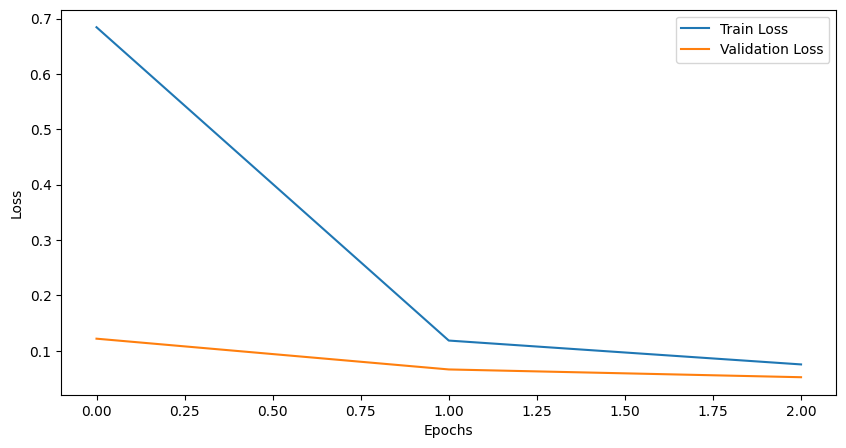

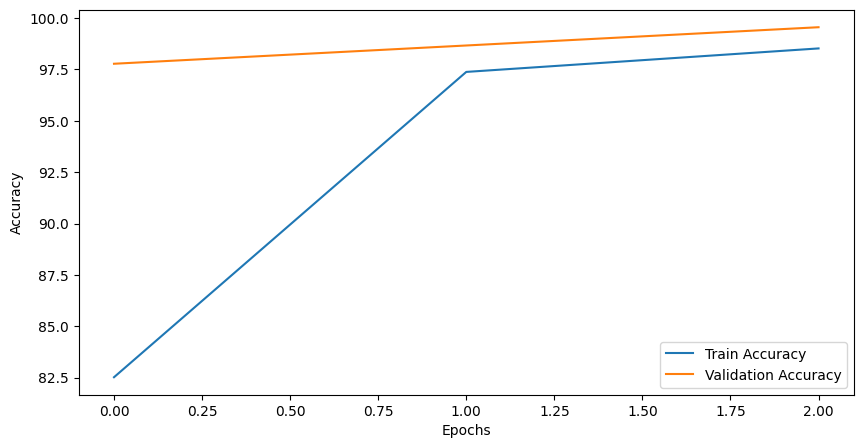

In [58]:
# TO-DO
import matplotlib.pyplot as plt

# Plot training and validation loss
plt.figure(figsize=(10,5))
plt.plot(train_loss_list, label='Train Loss')
plt.plot(val_loss_list, label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Plot training and validation accuracy
plt.figure(figsize=(10,5))
plt.plot(train_accuracy_list, label='Train Accuracy')
plt.plot(val_accuracy_list, label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


# Evaluating the Model

In [59]:
# TO-DO
# Evaluation
model.eval()
test_loss, test_accuracy = run_1_epoch(model, loss_function, test_loader, optimizer, train=False)
print(f"Test Accuracy: {test_accuracy:.2f}%")


100%|██████████| 8/8 [00:02<00:00,  2.78it/s]

Test Accuracy: 98.00%


# TorchVision Pretrained ResNet-50 Model

# Step 1: Load and Modify ResNet-50 Model

In [60]:
# TO DO (For Instructions, Please Refimport torch
import torch.nn as nn
from torchvision import models

# Load the pretrained ResNet-50 model
pretrained_ResNet50_model = models.resnet50(pretrained=True)

# Modify the final fully connected layer to output 15 classes
num_features = pretrained_ResNet50_model.fc.in_features
pretrained_ResNet50_model.fc = nn.Linear(num_features, 15)


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 175MB/s]


# Step 2: Define the Loss Function, Optimizer, and Scheduler

In [61]:
# Loss function
loss_function = nn.CrossEntropyLoss()

# Optimizer
optimizer = torch.optim.Adam(pretrained_ResNet50_model.parameters(), lr=0.001)
# Scheduler (optional, to reduce learning rate during training)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=40, gamma=0.1)


# Step 3: Set Up TensorBoard Logging

In [62]:
from torch.utils.tensorboard import SummaryWriter

# Initialize TensorBoard writer for ResNet-50
writer_resnet = SummaryWriter('runs/resnet50_vegetable_classification')
# Set up device (GPU if available, otherwise CPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Move model to device
pretrained_ResNet50_model = pretrained_ResNet50_model.to(device)



Using device: cuda


In [63]:
def run_1_epoch(model, loss_function, data_loader, optimizer, train=True):
    epoch_loss = 0.0
    correct = 0
    total = 0

    for inputs, targets in data_loader:
        # Move inputs and targets to the same device as the model
        inputs, targets = inputs.to(device), targets.to(device)

        if train:
            optimizer.zero_grad()

        # Forward pass
        outputs = model(inputs)
        loss = loss_function(outputs, targets)

        if train:
            # Backward pass and optimization
            loss.backward()
            optimizer.step()

        # Track accuracy
        _, predicted = outputs.max(1)
        total += targets.size(0)
        correct += predicted.eq(targets).sum().item()

        epoch_loss += loss.item()

    epoch_loss /= len(data_loader)
    epoch_accuracy = 100. * correct / total

    return epoch_loss, epoch_accuracy


# Step 4: Train ResNet-50 Model

In [64]:
num_epochs = 3
train_loss_list_resnet = []
val_loss_list_resnet = []
train_accuracy_list_resnet = []
val_accuracy_list_resnet = []
best_val_accuracy_resnet = 0.0

for epoch in range(num_epochs):
    print(f"Epoch {epoch + 1}/{num_epochs} - ResNet-50 Training")

    # Training phase
    pretrained_ResNet50_model.train()
    train_loss, train_accuracy = run_1_epoch(pretrained_ResNet50_model, loss_function, train_loader, optimizer, train=True)
    train_loss_list_resnet.append(train_loss)
    train_accuracy_list_resnet.append(train_accuracy)
    writer_resnet.add_scalar('Loss/train', train_loss, epoch)
    writer_resnet.add_scalar('Accuracy/train', train_accuracy, epoch)

    # Validation phase
    pretrained_ResNet50_model.eval()
    with torch.no_grad():
        val_loss, val_accuracy = run_1_epoch(pretrained_ResNet50_model, loss_function, val_loader, optimizer, train=False)
    val_loss_list_resnet.append(val_loss)
    val_accuracy_list_resnet.append(val_accuracy)
    writer_resnet.add_scalar('Loss/val', val_loss, epoch)
    writer_resnet.add_scalar('Accuracy/val', val_accuracy, epoch)

    # Update scheduler
    scheduler.step()

    # Save best model
    if val_accuracy > best_val_accuracy_resnet:
        best_val_accuracy_resnet = val_accuracy
        torch.save(pretrained_ResNet50_model.state_dict(), 'ResNet50_best_val_checkpoint.pth')
        print(f"New best validation accuracy for ResNet-50: {best_val_accuracy_resnet:.4f}")

    print(f"ResNet-50 - Train Loss: {train_loss:.4f}, Validation Loss: {val_loss:.4f}")
    print(f"ResNet-50 - Train Accuracy: {train_accuracy:.2f}%, Validation Accuracy: {val_accuracy:.2f}%")

# Close TensorBoard writer
writer_resnet.close()


Epoch 1/3 - ResNet-50 Training
New best validation accuracy for ResNet-50: 57.5556
ResNet-50 - Train Loss: 0.6880, Validation Loss: 3.7466
ResNet-50 - Train Accuracy: 80.38%, Validation Accuracy: 57.56%
Epoch 2/3 - ResNet-50 Training
New best validation accuracy for ResNet-50: 88.8889
ResNet-50 - Train Loss: 0.3042, Validation Loss: 0.3514
ResNet-50 - Train Accuracy: 91.29%, Validation Accuracy: 88.89%
Epoch 3/3 - ResNet-50 Training
New best validation accuracy for ResNet-50: 98.6667
ResNet-50 - Train Loss: 0.1216, Validation Loss: 0.0317
ResNet-50 - Train Accuracy: 96.48%, Validation Accuracy: 98.67%


# Step 5: Plot Training and Validation Metrics

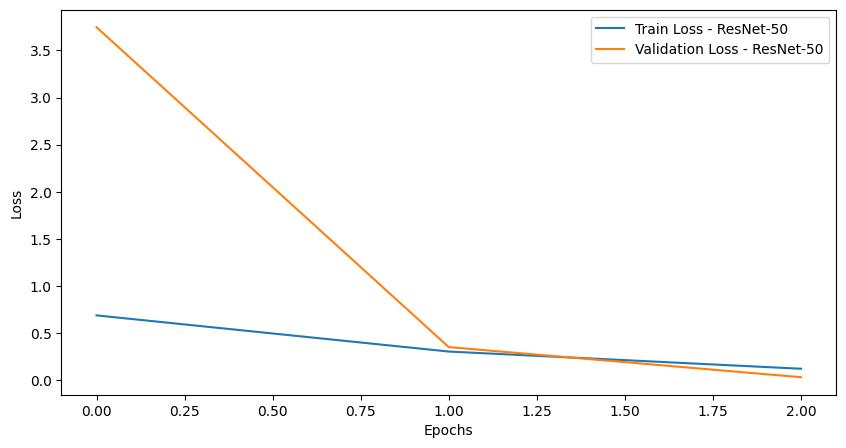

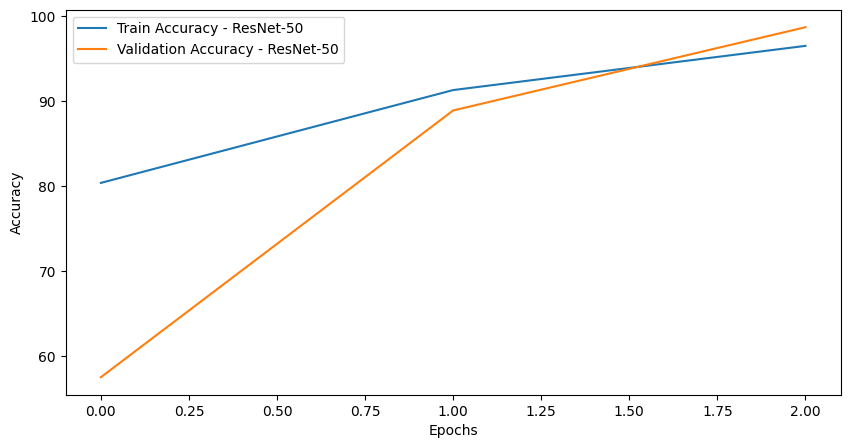

In [65]:
import matplotlib.pyplot as plt

# Plot training and validation loss for ResNet-50
plt.figure(figsize=(10,5))
plt.plot(train_loss_list_resnet, label='Train Loss - ResNet-50')
plt.plot(val_loss_list_resnet, label='Validation Loss - ResNet-50')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Plot training and validation accuracy for ResNet-50
plt.figure(figsize=(10,5))
plt.plot(train_accuracy_list_resnet, label='Train Accuracy - ResNet-50')
plt.plot(val_accuracy_list_resnet, label='Validation Accuracy - ResNet-50')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()


# Step 6: Evaluate the Model on Test Set

In [66]:
# Evaluate ResNet-50 on test set
pretrained_ResNet50_model.eval()
with torch.no_grad():
    test_loss_resnet, test_accuracy_resnet = run_1_epoch(pretrained_ResNet50_model, loss_function, test_loader, optimizer, train=False)

print(f"ResNet-50 Test Accuracy: {test_accuracy_resnet:.2f}%")


ResNet-50 Test Accuracy: 98.00%


**Submission**

**Its an individual lab.**
**Please submit notebook and answers to the questions with proper analysis.**

# Analysis

## Task 1: VGG16 Model (From Scratch vs. Pretrained)

### VGG16 From Scratch
- **Training Accuracy**: Reached 29.43% by epoch 14.
- **Validation Accuracy**: Peaked at 34.67% and ultimately dropped to 33.11%.
- **Loss**: The training and validation loss decreased initially but plateaued quickly, suggesting limited learning capacity.
- **Observation**: Training from scratch did not yield high accuracy, which is typical as VGG16 requires extensive training data and time to converge due to its depth and number of parameters.

### VGG16 Pretrained (Fine-Tuned for 3 Epochs)
- **Training Accuracy**: Achieved 98.52%.
- **Validation Accuracy**: Achieved 99.56%.
- **Loss**: Both training and validation losses dropped sharply, indicating successful learning and convergence.
- **Observation**: Fine-tuning the pretrained model led to much higher accuracy and quicker convergence compared to training from scratch. This demonstrates the advantage of transfer learning, where pretrained models with learned features can adapt quickly to similar tasks.


## Task 2: ResNet-50 Pretrained (Fine-Tuned for 3 Epochs)
- **Training Accuracy**: Improved from 80.38% to 96.48%.
- **Validation Accuracy**: Improved significantly, reaching 98.67%.
- **Loss**: The validation loss decreased rapidly across the three epochs, while training loss also decreased steadily, showing effective learning.
- **Observation**: The ResNet-50 model, with its residual connections, achieved high accuracy and convergence with fewer epochs than the VGG16 model, showing ResNet's efficiency and suitability for complex datasets.


## Personal Comparison and Observations

1. **Training from Scratch vs. Pretrained**: Training VGG16 from scratch yielded low accuracy and high loss, indicating it struggled without pretrained weights. The pretrained VGG16 and ResNet-50 models performed significantly better, with the pretrained VGG16 model achieving high accuracy even in fewer epochs.
   
2. **ResNet-50 vs. VGG16**: ResNet-50 outperformed VGG16 in validation accuracy with a faster convergence rate, demonstrating the advantage of ResNet's architecture, especially for deeper networks.

3. **Implications**: Fine-tuning pretrained models is highly effective for achieving high accuracy in fewer epochs. ResNet-50 is more efficient and achieved comparable performance to VGG16 with fewer epochs, suggesting that ResNet may be a better choice for similar tasks due to its residual learning capabilities.


### Useful repositories for gradcam and visualizations.
https://github.com/jacobgil/pytorch-grad-cam

https://github.com/utkuozbulak/pytorch-cnn-visualizations


# Notebook Source
https://github.com/Vision-At-SEECS/Pytorch_Labs/blob/main/Lab3_Transfer_Learning_and_GradCAM.ipynb

You may explore other notebooks in the link of the repository given above.

